In [1]:
import sctpt as st
import scanpy as sc
import anndata
import scvelo as scv

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/pyemma/__init__.py:92: UserWarning: You are not using the latest release of PyEMMA. Latest is 2.5.7, you have 2.5.6.
  .format(latest=latest, current=current), category=UserWarning)


In [3]:
adata = scv.datasets.bonemarrow()

In [4]:
adata = adata[adata.obs['clusters']!='CLP',:]

In [5]:
adata

View of AnnData object with n_obs × n_vars = 5292 × 14319
    obs: 'clusters', 'palantir_pseudotime'
    uns: 'clusters_colors'
    obsm: 'X_tsne'
    layers: 'spliced', 'unspliced'

Trying to set attribute `.obs` of view, copying.


Filtered out 8418 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:13) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)


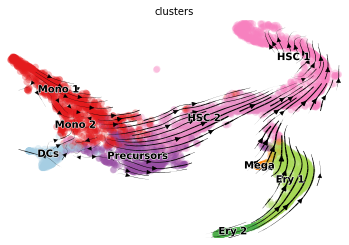

In [6]:
scv.pp.filter_and_normalize(adata, min_shared_counts=30, n_top_genes=2000)
scv.pp.moments(adata)
scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)
scv.pl.velocity_embedding_stream(adata, basis='tsne', color=['clusters'])

In [7]:
import numpy as np
import anndata
U = adata.layers['unspliced']
S = adata.layers['spliced']
if 'toarray' in dir(U):
    U = U.toarray()
    S = S.toarray()
X_all = np.concatenate((U,S),axis = 1)
adata_aggr = anndata.AnnData(X=X_all)
sc.tl.pca(adata_aggr, svd_solver='arpack')
sc.pp.neighbors(adata_aggr)
sc.tl.umap(adata_aggr)

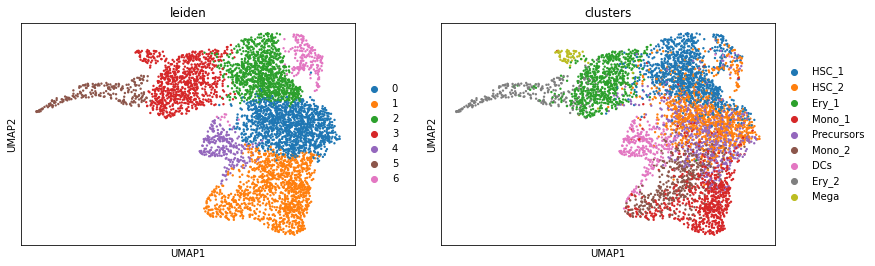

In [8]:
sc.tl.leiden(adata_aggr,resolution = 0.38)
adata_aggr.obs['clusters']=adata.obs['clusters'].values
sc.pl.umap(adata_aggr,color = ['leiden','clusters'])

In [9]:
adata.obs['attractor'] = adata_aggr.obs['leiden'].values
adata_aggr = st.dynamical_iteration(adata,n_states =7, n_iter = 20, return_aggr_obj=True, weight_connectivities = 0.5,n_components = 21, n_neighbors = 100,thresh_ms_gene = 0.2,thresh_entropy = 0.2)

  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

2.021698168407669


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.6523445718911458


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.6555687933707924


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.4258446678227812


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.2367858374648153


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.27280857637918654


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.3583103213478409


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.38316535341598157


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.47417736572982205


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.610113692518526


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.5164508524137301


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.29095443997639014


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

0.2799523170985312


  0%|          | 0/5292 [00:00<?, ?cell/s]

  0%|          | 0/5292 [00:00<?, ?cell/s]

Trying to set attribute `.obs` of view, copying.


0.186608991067164


In [10]:
sc.pp.neighbors(adata_aggr)
sc.tl.umap(adata_aggr)

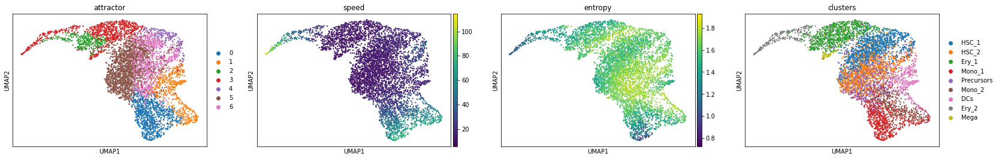

In [11]:
adata_aggr.obs['clusters'] = adata.obs['clusters'].values
sc.pl.umap(adata_aggr,color = ['attractor','speed','entropy','clusters'])

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/sklearn/mixture/_base.py:269: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  % (init + 1), ConvergenceWarning)


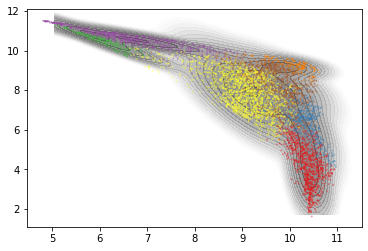

In [12]:
adata.obsm['X_umap'] = adata_aggr.obsm['X_umap']
st.construct_landscape(adata,thresh_cal_cov = 0.5,scale_land = 0.9,scale_axis = 1.05, N_grid = 500)
st.plot_landscape(adata,dim=2)

In [13]:
scv.tl.velocity_graph(adata_aggr,sqrt_transform=True,n_neighbors = 10)
adata_aggr.obsm['X_trans_coord']=adata.uns['land_out']['trans_coord']

computing velocity graph (using 1/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


computing velocity embedding
    finished (0:00:01) --> added
    'velocity_trans_coord', embedded velocity vectors (adata.obsm)
figure cannot be saved as pdf, using png instead.
saving figure to file ./figures/scvelo_bm_velo.png


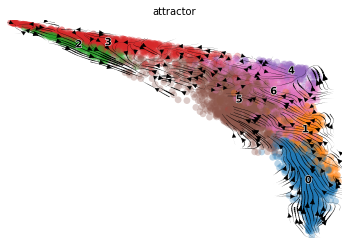

In [14]:
scv.pl.velocity_embedding_stream(adata_aggr, basis='trans_coord', color='attractor',density = 4, save = 'bm_velo.pdf')

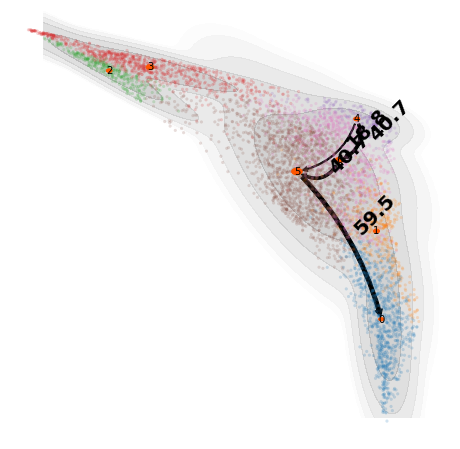

In [15]:
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(8, 8))
st.infer_lineage(adata,si=4,sf=0,method = 'MPPT',flux_fraction = 0.5,size_point = 10,contour_levels = 5, alpha_land = 0.2, alpha_point = 0.2,color_palette_name = 'tab10')
#plt.savefig('./figures/bm_tpt1.pdf',dpi = 800,bbox_inches = 'tight')

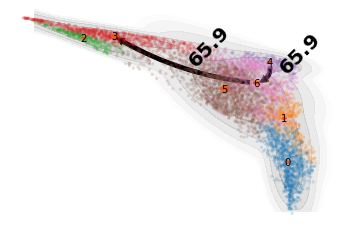

In [16]:
st.infer_lineage(adata,si=4,sf=3,method = 'MPPT',flux_fraction = 0.5,size_point = 10,contour_levels = 5, alpha_land = 0.2, alpha_point = 0.2,color_palette_name = 'tab10')
#plt.savefig('./figures/bm_tpt2.pdf',dpi = 800,bbox_inches = 'tight')

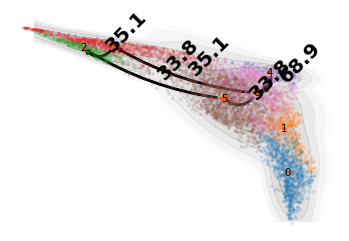

In [17]:
st.infer_lineage(adata,si=4,sf=2,method = 'MPPT',flux_fraction = 0.5,size_point = 10,contour_levels = 5, alpha_land = 0.2, alpha_point = 0.2,color_palette_name = 'tab10')

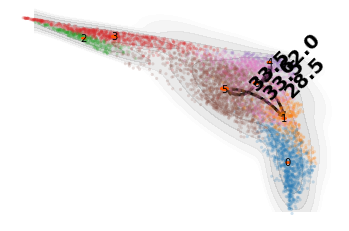

In [18]:
st.infer_lineage(adata,si=4,sf=1,method = 'MPPT',flux_fraction = 0.5,size_point = 10,contour_levels = 5, alpha_land = 0.2, alpha_point = 0.2,color_palette_name = 'tab10')

/Users/cliffzhou/Documents/GitHub/sctpt/sctpt.py:148: UserWarning: Z contains NaN values. This may result in rendering artifacts.
  ax.plot_surface(xv, yv,land_value,rstride=1, cstride=1, linewidth=0, antialiased=True,cmap="Greys_r", alpha = alpha_land, vmin = 0, vmax=np.nanmax(land_value), shade = True)


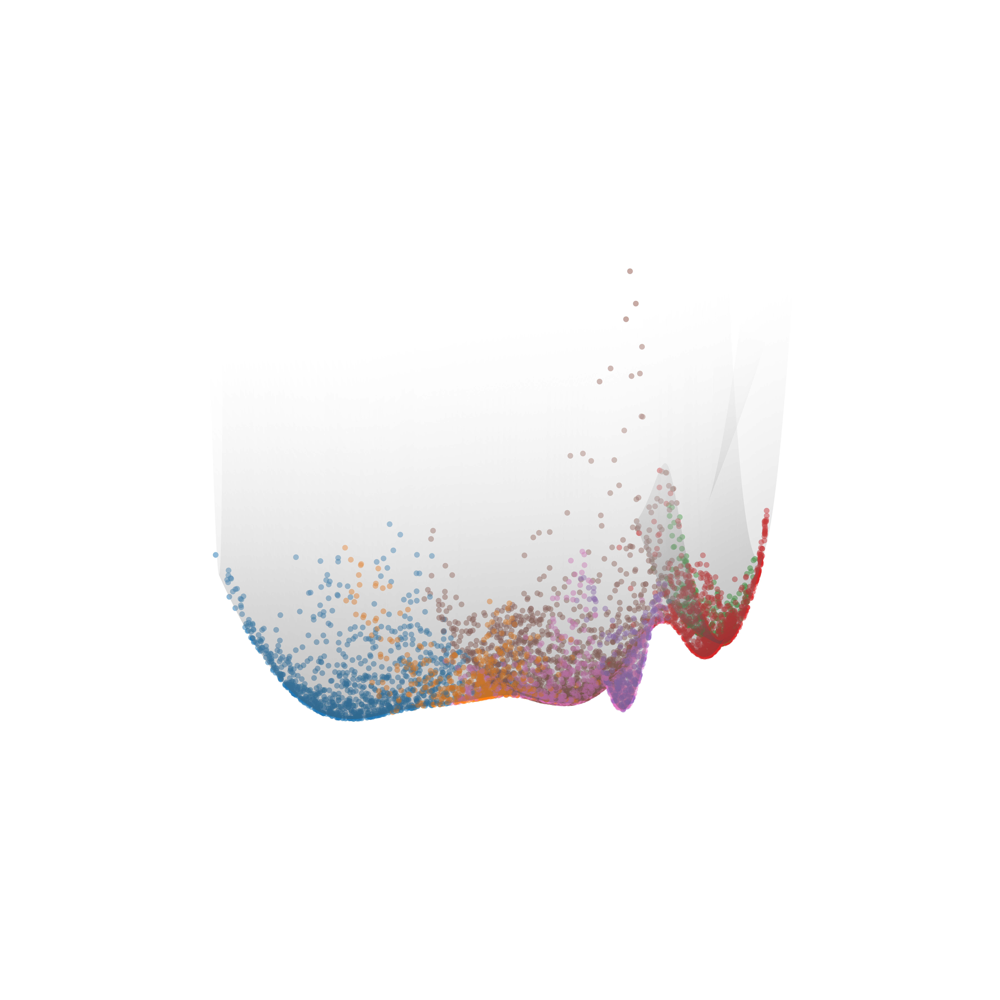

In [19]:
fig = plt.figure(figsize = (10,10),dpi = 800)
st.plot_landscape(adata,dim=3, alpha_land = 0.2,size_point = 10, azim = 5, elev = 13,color_palette_name = 'tab10')

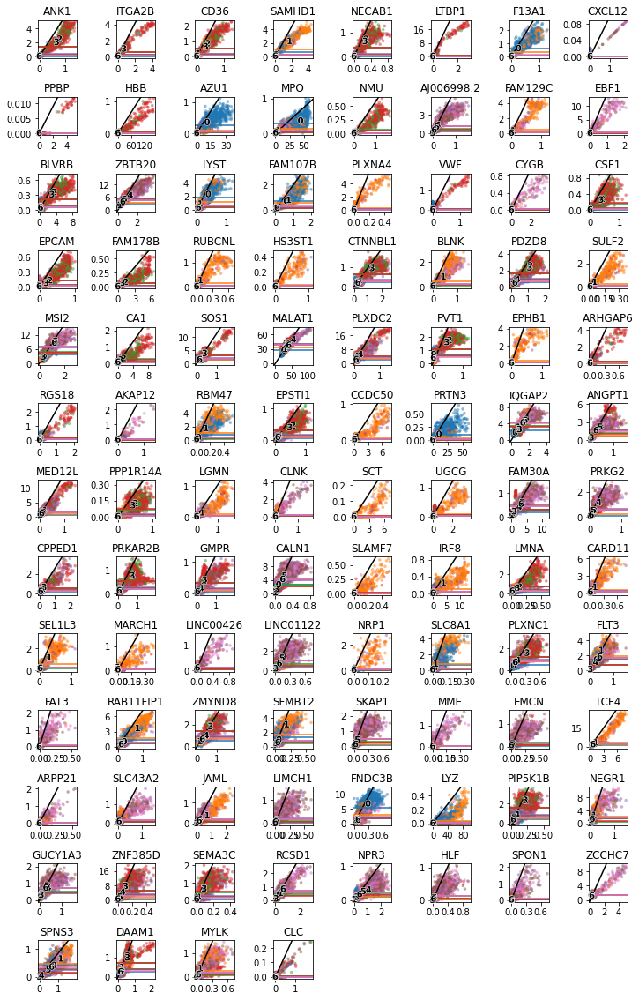

In [20]:
st.plot_top_genes(adata, top_genes = 100, ncols =8, wspace = 1, hspace = 1, figsize = (12,20))

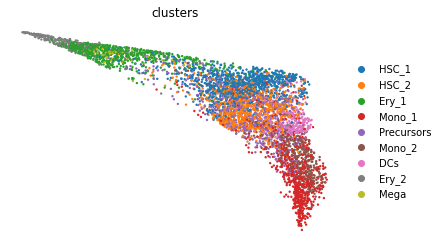

In [21]:
sc.pl.embedding(adata_aggr,color = ['clusters'],basis = 'trans_coord',frameon=False, save = 'bm_clusters.pdf')

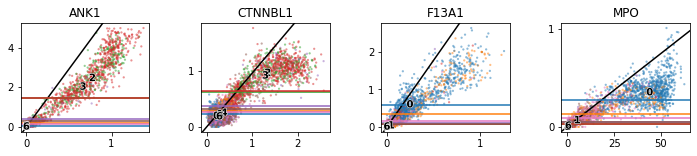

In [22]:
st.plot_genes_list(adata, genelist = ['ANK1','CTNNBL1','F13A1','MPO'], figsize =(12,2) ,ncols =4, wspace = 0.4, hspace = 1)
plt.savefig('./figures/bm_genes.pdf',dpi = 800,bbox_inches = 'tight')

In [23]:
adata_aggr

AnnData object with n_obs × n_vars = 5292 × 760
    obs: 'entropy', 'attractor', 'speed', 'clusters', 'velocity_self_transition'
    var: 'highly_variable'
    uns: 'pca', 'neighbors', 'T_fwd_params', 'eig_fwd', 'gene_subset', 'umap', 'attractor_colors', 'clusters_colors', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap', 'X_trans_coord', 'velocity_trans_coord'
    varm: 'PCs'
    layers: 'velocity', 'spliced', 'Ms'
    obsp: 'distances', 'connectivities', 'T_fwd'

In [52]:
sc.set_figure_params(dpi=600,fontsize = 10)
import matplotlib as mpl
mpl.rcParams['axes.grid'] = False
adata.obsm['X_trans_coord_aggr']=adata_aggr.obsm['X_trans_coord']
st.plot_tensor(adata, adata_aggr,  basis = 'trans_coord',list_attractor = [0,1,2,3])

check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:12) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vj_trans_coord', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vj_trans_coord', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:03) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vj_trans_coord', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vj_trans_coord', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:13) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:06) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:06) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:08) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:08) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:06) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:06) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:08) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_trans_coord_aggr', embedded velocity vectors (adata.obsm)


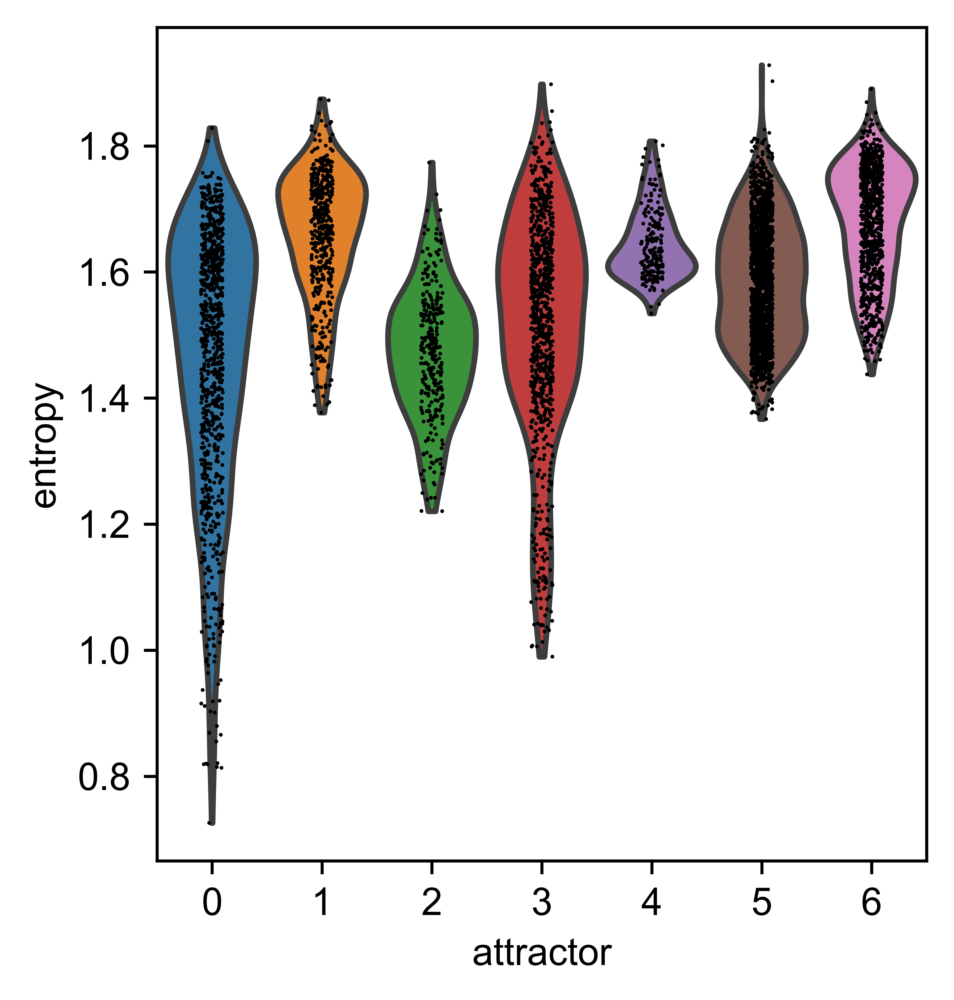

In [25]:
sc.pl.violin(adata, keys = ['entropy'], groupby='attractor')

In [13]:
sc.set_figure_params(dpi=600,fontsize = 12, figsize = (8,6))
sc.pl.violin(adata, keys = ['entropy'], groupby='clusters',palette ='tab10')

In [9]:
adata.obs['entropy'].min()

0.7260409392852957

In [27]:
adata.write('adata_bm_0801.h5ad')
adata_aggr.write('adata_aggr_bm_0823.h5ad')

In [2]:
adata = sc.read_h5ad('adata_bm_0801.h5ad')
adata_aggr=sc.read_h5ad('adata_aggr_bm_0823.h5ad')

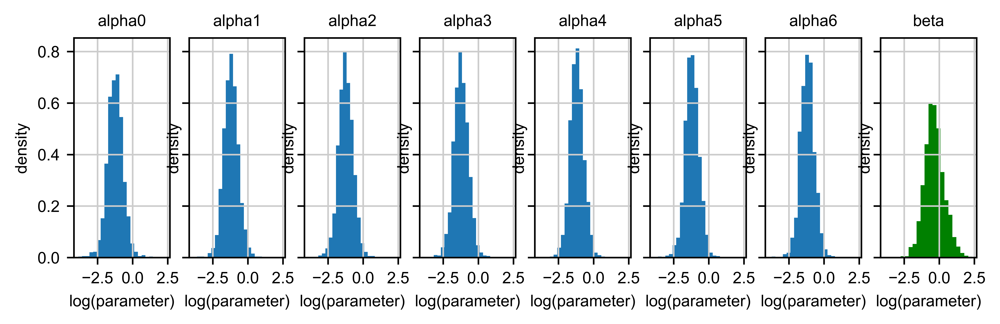

In [36]:
import importlib
importlib.reload(st)
st.plot_para_hist(adata,figsize=(8,2))

computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:12) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_trans_coord', embedded velocity vectors (adata.obsm)


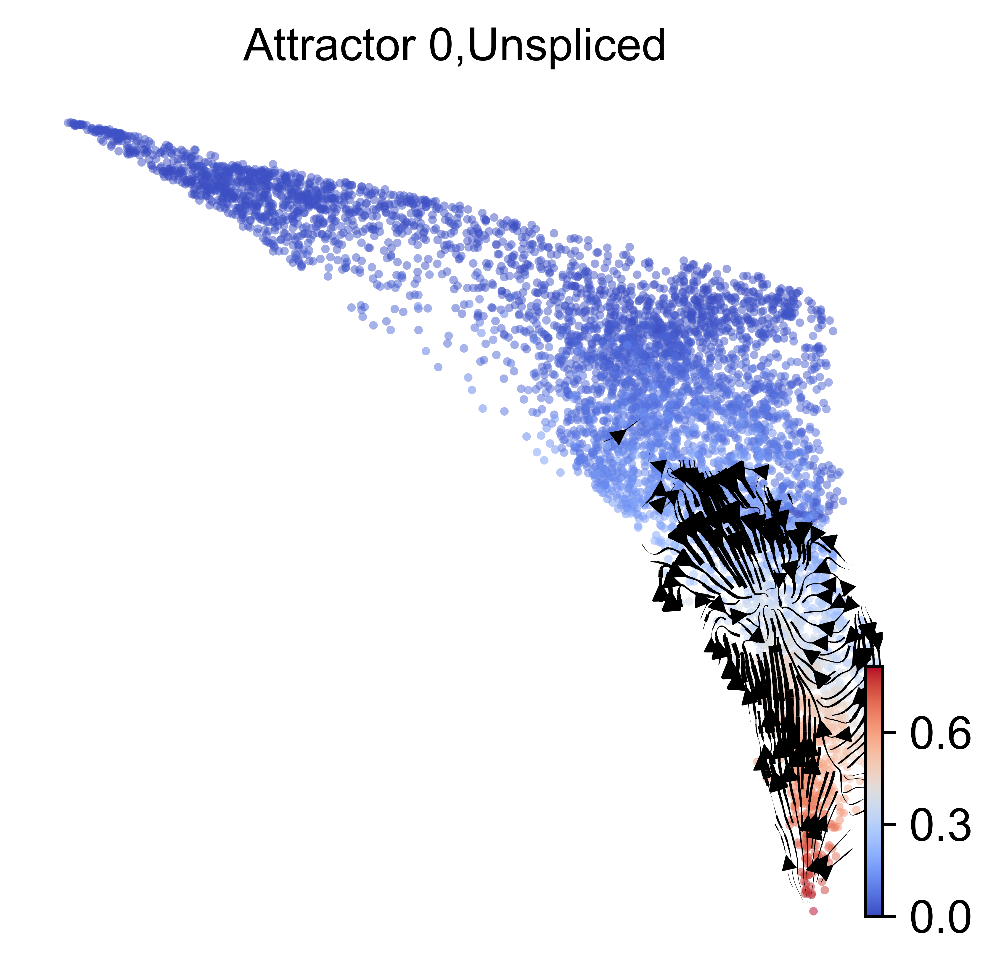

In [46]:
sc.set_figure_params(dpi=600,fontsize = 12)
mpl.rcParams['axes.grid'] = False
adata.obsm['X_trans_coord']=adata_aggr.obsm['X_trans_coord']
st.plot_tensor_single(adata, adata_aggr,  basis = 'trans_coord', state = 'unspliced',attractor = 0,filter_cells = True, member_thresh = 0.2)

computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:08) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_trans_coord', embedded velocity vectors (adata.obsm)


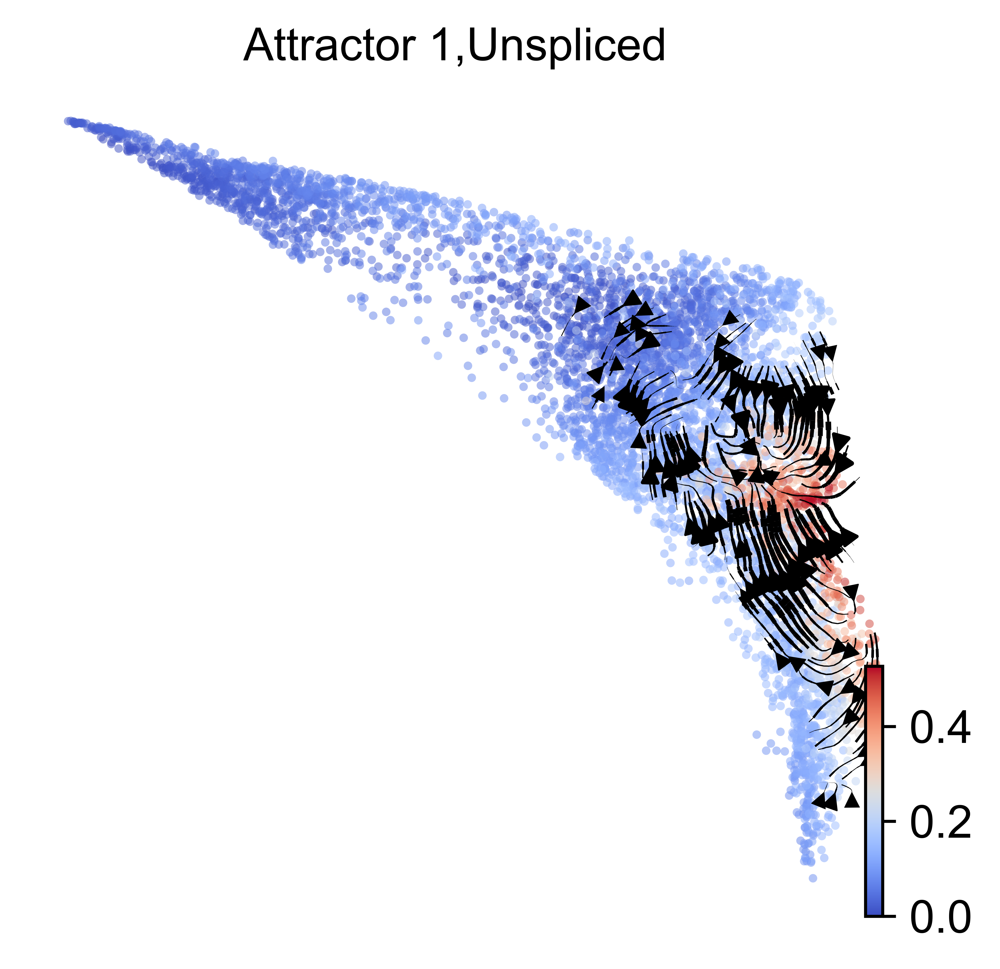

In [48]:
st.plot_tensor_single(adata, adata_aggr,  basis = 'trans_coord', state = 'unspliced',attractor = 1,filter_cells = True, member_thresh = 0.2)

computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:08) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_trans_coord', embedded velocity vectors (adata.obsm)


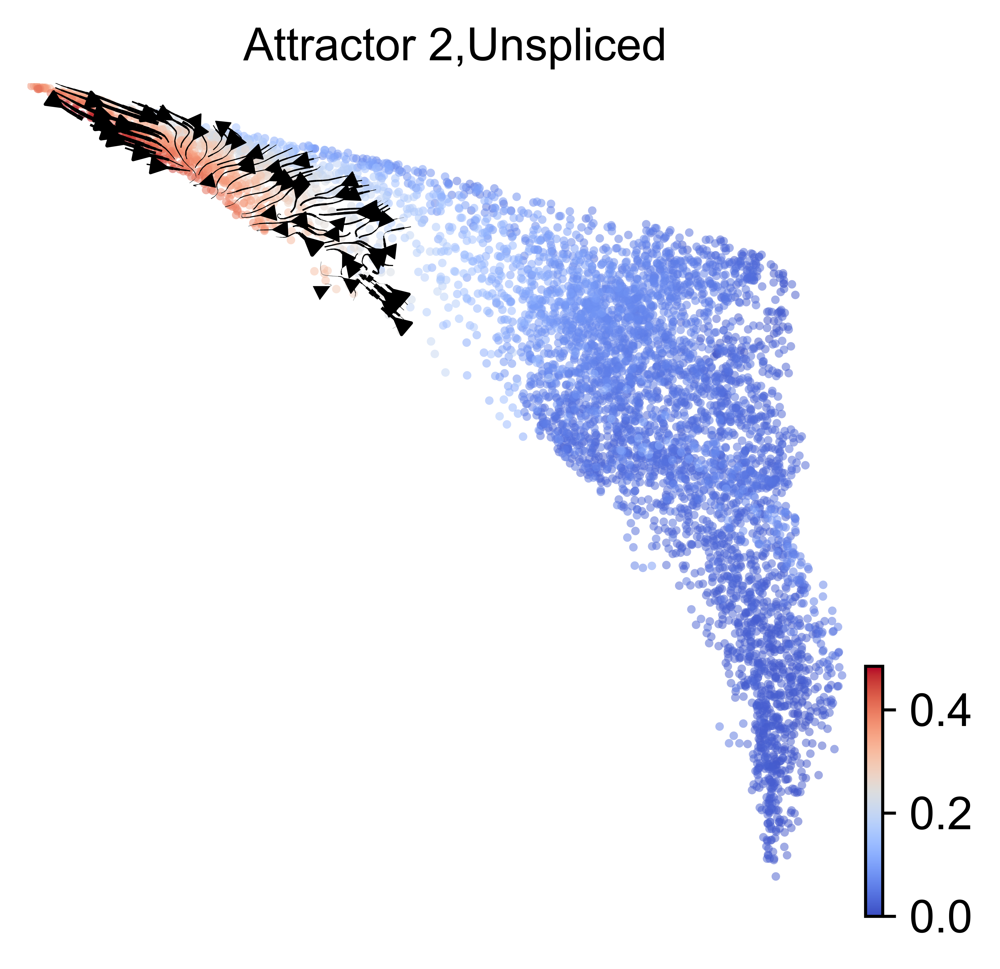

In [50]:
st.plot_tensor_single(adata, adata_aggr,  basis = 'trans_coord', state = 'unspliced',attractor = 2,filter_cells = True, member_thresh = 0.2)

computing velocity graph (using 8/8 cores)


  0%|          | 0/5292 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:10) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_trans_coord', embedded velocity vectors (adata.obsm)


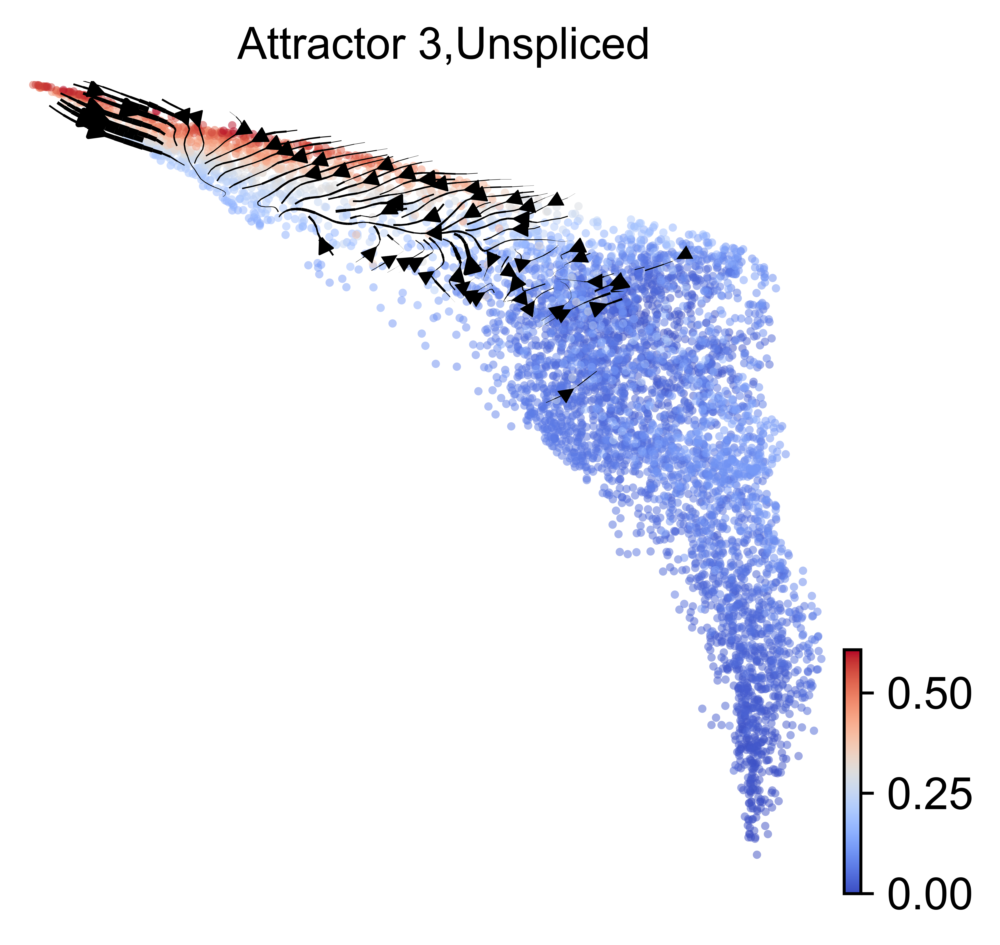

In [51]:
st.plot_tensor_single(adata, adata_aggr,  basis = 'trans_coord', state = 'unspliced',attractor = 3,filter_cells = True, member_thresh = 0.2)

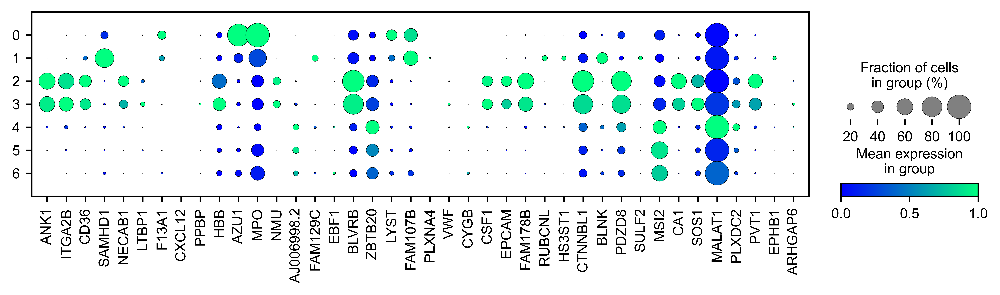

In [53]:
gene_sort = adata.var['r2'].sort_values(ascending=False).index.tolist()
sc.pl.DotPlot(adata, gene_sort[0:40], groupby='attractor',figsize = (10,2),layer = 'spliced',standard_scale = 'var').show()

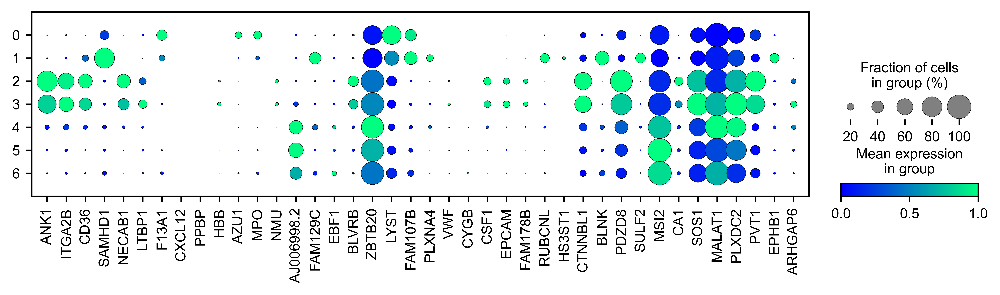

In [54]:
gene_sort = adata.var['r2'].sort_values(ascending=False).index.tolist()
sc.pl.DotPlot(adata, gene_sort[0:40], groupby='attractor',figsize = (10,2),layer = 'unspliced',standard_scale = 'var').show()

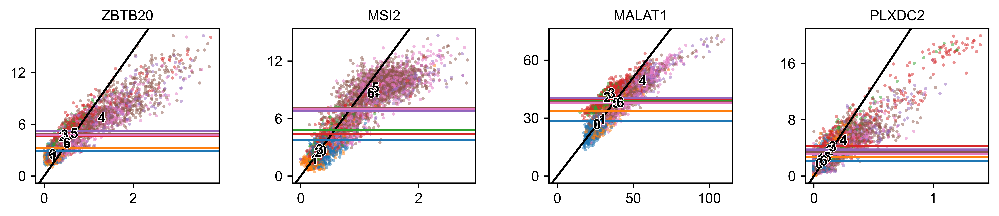

In [57]:
st.plot_genes_list(adata, genelist = ['ZBTB20','MSI2','MALAT1','PLXDC2'], figsize =(12,2) ,ncols =4, wspace = 0.4, hspace = 1)